In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import vgg19
from IPython.display import Image, display

In [ ]:
base_image_path = keras.utils.get_file("eiffel.jpg", "https://cdn.theculturetrip.com/wp-content/uploads/2018/05/eiffel-tower-3349075_1280-1-1024x682.jpg")
style_reference_image_path = keras.utils.get_file("christmas.jpg", "https://artist.com/photos/arts/big/new-year-and-christmas-card-tree-with-snowflakes-set-in-the-style-of-van-gogh-345745266.jpg")
result_prefix = "eiffel christmas_generated"

249083/249083 [==============================] - 0s 1us/step


In [ ]:
total_variation_weight = 1e-6
style_weight = 1e-6
content_weight = 2.5e-8

In [ ]:
width, height = keras.preprocessing.image.load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)


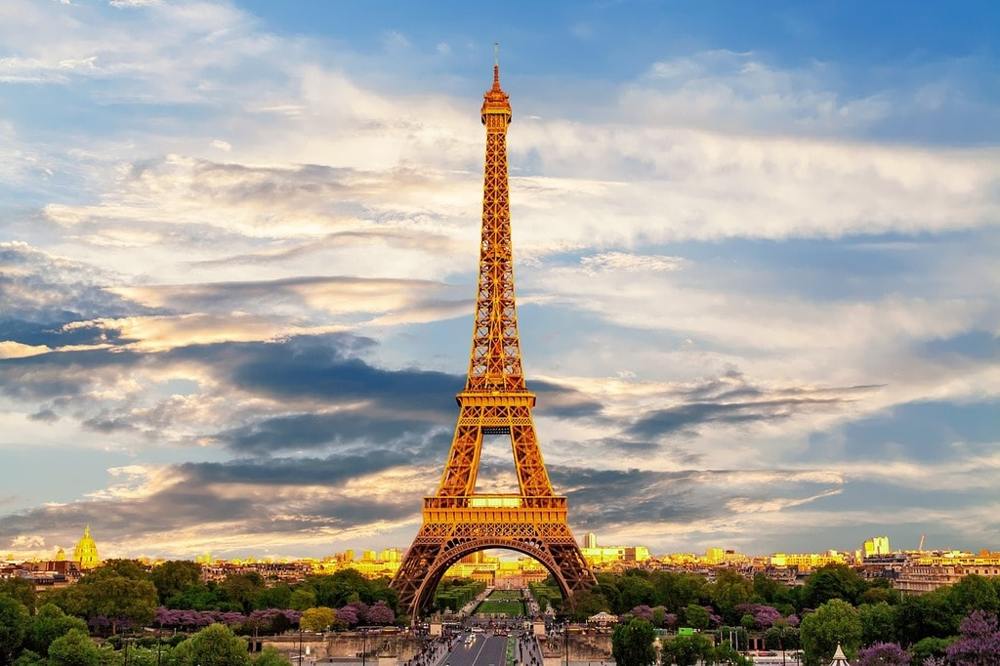

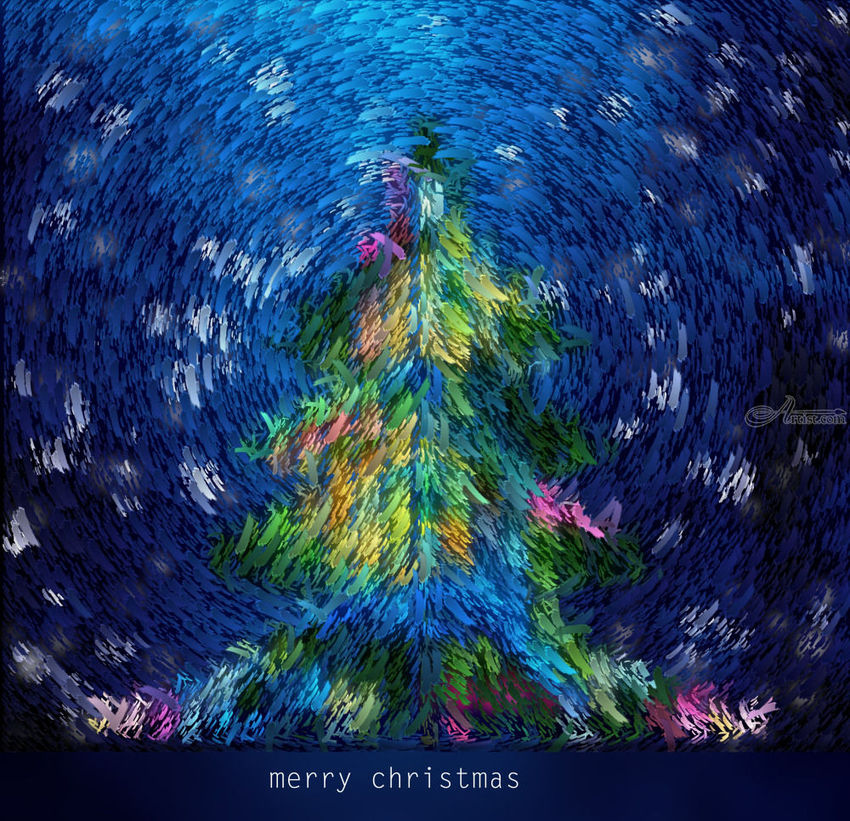

In [ ]:
display(Image(base_image_path))
display(Image(style_reference_image_path))

In [ ]:
def preprocess_image(image_path):
    # Util function to open, resize and format pictures into appropriate tensors
    img = keras.preprocessing.image.load_img(
        image_path, target_size=(img_nrows, img_ncols)
    )
    img = keras.preprocessing.image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return tf.convert_to_tensor(img)

In [ ]:
def deprocess_image(x):
    # Util function to convert a tensor into a valid image
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype("uint8")
    return x

In [ ]:
def gram_matrix(x):
    x = tf.transpose(x, (2, 0, 1))
    features = tf.reshape(x, (tf.shape(x)[0], -1))
    gram = tf.matmul(features, tf.transpose(features))
    return gram

In [ ]:

def style_loss(style, combination):
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return tf.reduce_sum(tf.square(S - C)) / (4.0 * (channels**2) * (size**2))

In [ ]:

def content_loss(base, combination):
    return tf.reduce_sum(tf.square(combination - base))


In [ ]:
def total_variation_loss(x):
    a = tf.square(
        x[:, : img_nrows - 1, : img_ncols - 1, :] - x[:, 1:, : img_ncols - 1, :]
    )
    b = tf.square(
        x[:, : img_nrows - 1, : img_ncols - 1, :] - x[:, : img_nrows - 1, 1:, :]
    )
    return tf.reduce_sum(tf.pow(a + b, 1.25))

In [ ]:
model = vgg19.VGG19(weights="imagenet", include_top=False)

# Get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

# Set up a model that returns the activation values for every layer in
# VGG19 (as a dict).
feature_extractor = keras.Model(inputs=model.inputs, outputs=outputs_dict)

80134624/80134624 [==============================] - 0s 0us/step


In [ ]:
# List of layers to use for the style loss.
style_layer_names = [
    "block1_conv1",
    "block2_conv1",
    "block3_conv1",
    "block4_conv1",
    "block5_conv1",
]
# The layer to use for the content loss.
content_layer_name = "block5_conv2"

In [ ]:
def compute_loss(combination_image, base_image, style_reference_image):
    input_tensor = tf.concat(
        [base_image, style_reference_image, combination_image], axis=0
    )
    features = feature_extractor(input_tensor)

    # Initialize the loss
    loss = tf.zeros(shape=())

    # Add content loss
    layer_features = features[content_layer_name]
    base_image_features = layer_features[0, :, :, :]
    combination_features = layer_features[2, :, :, :]
    loss = loss + content_weight * content_loss(
        base_image_features, combination_features
    )
    # Add style loss
    for layer_name in style_layer_names:
        layer_features = features[layer_name]
        style_reference_features = layer_features[1, :, :, :]
        combination_features = layer_features[2, :, :, :]
        sl = style_loss(style_reference_features, combination_features)
        loss += (style_weight / len(style_layer_names)) * sl

    # Add total variation loss
    loss += total_variation_weight * total_variation_loss(combination_image)
    return loss


In [ ]:


@tf.function
def compute_loss_and_grads(combination_image, base_image, style_reference_image):
    with tf.GradientTape() as tape:
        loss = compute_loss(combination_image, base_image, style_reference_image)
    grads = tape.gradient(loss, combination_image)
    return loss, grads


Iteration 100: loss=7079.18


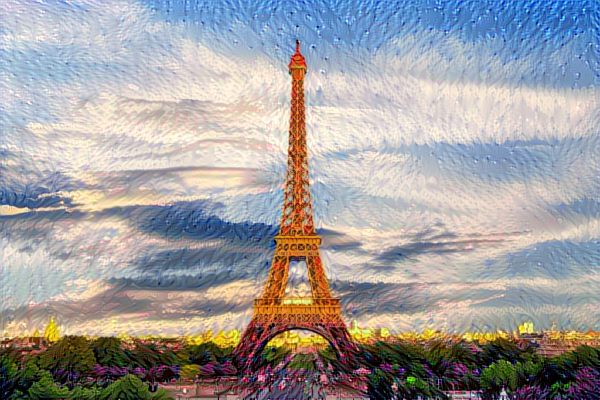

Iteration 200: loss=5650.87


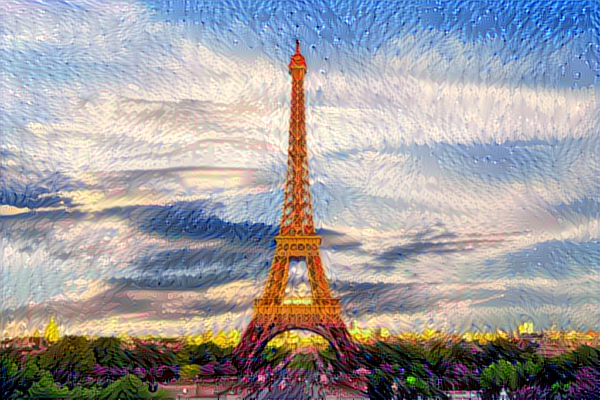

Iteration 300: loss=5033.71


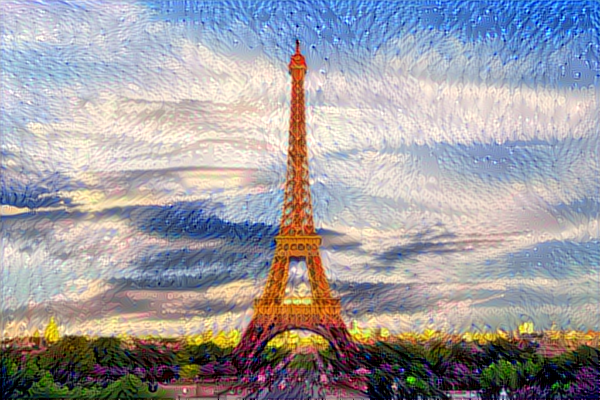

Iteration 400: loss=4659.45


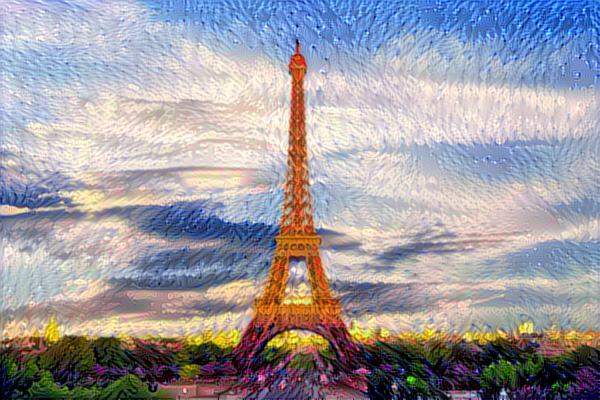

Iteration 500: loss=4395.86


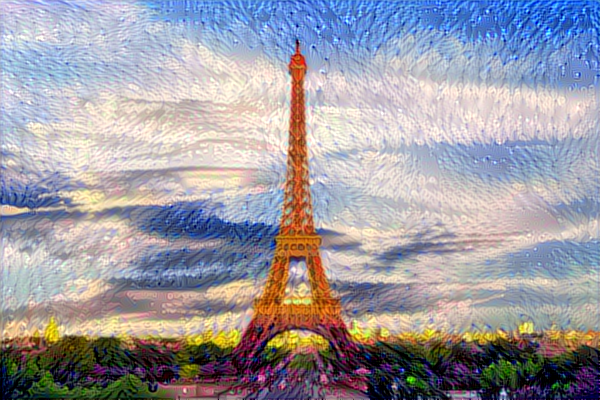

Iteration 600: loss=4196.26


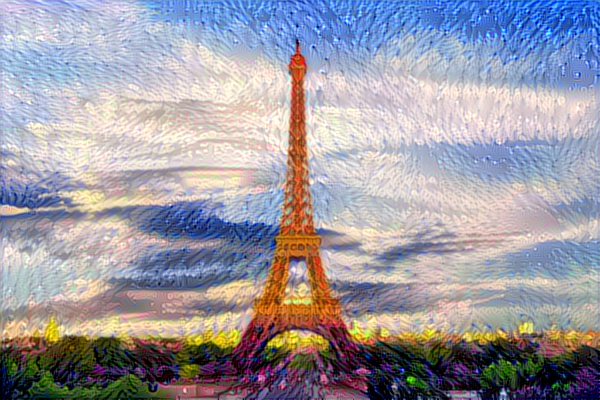

Iteration 700: loss=4037.21


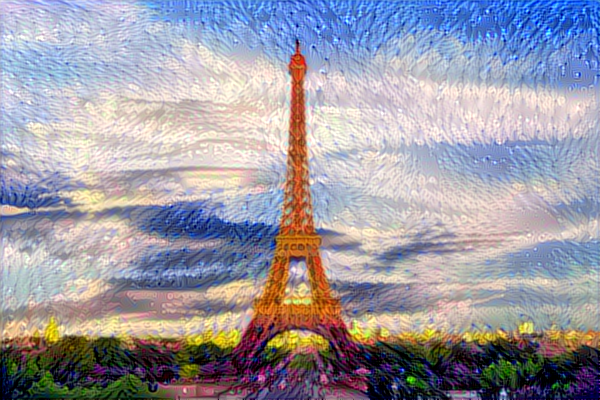

Iteration 800: loss=3906.20


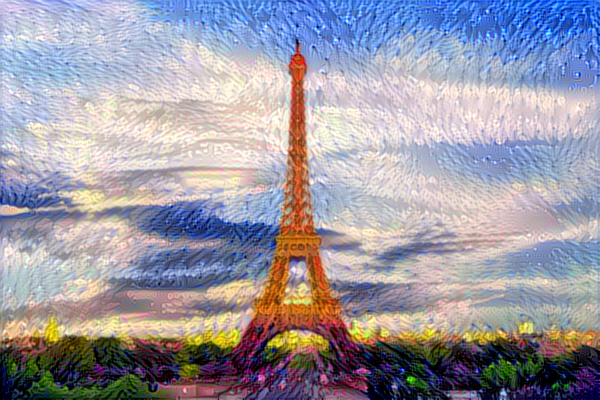

Iteration 900: loss=3795.77


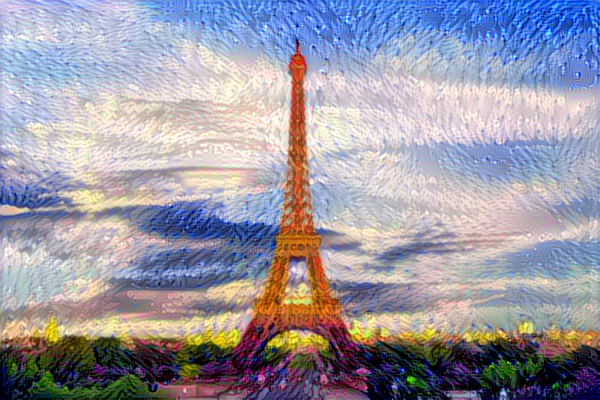

Iteration 1000: loss=3701.45


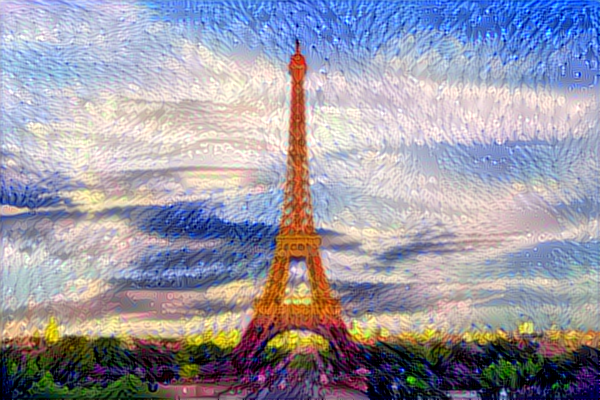

Iteration 1100: loss=3619.83


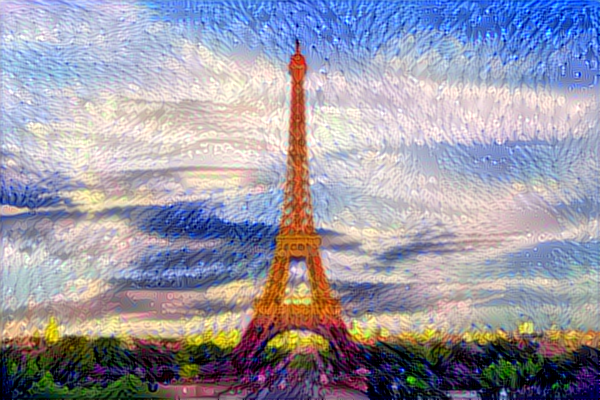

Iteration 1200: loss=3548.32


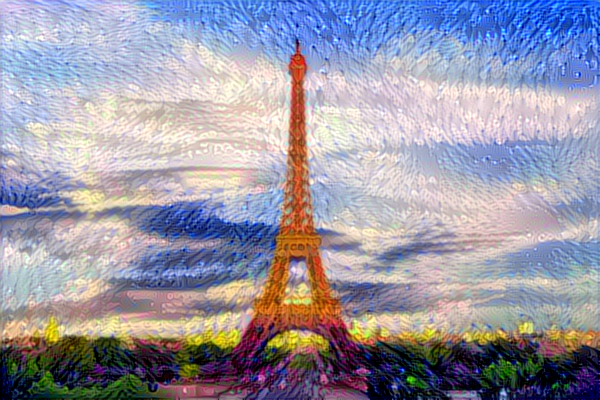

Iteration 1300: loss=3485.01


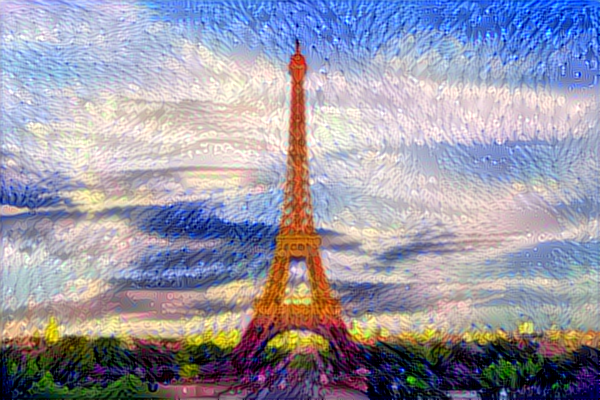

Iteration 1400: loss=3428.47


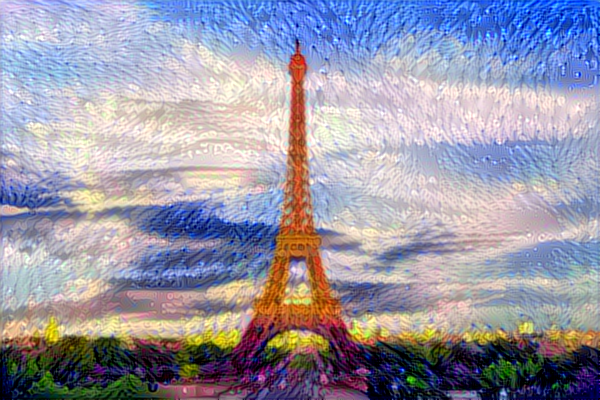

Iteration 1500: loss=3377.54


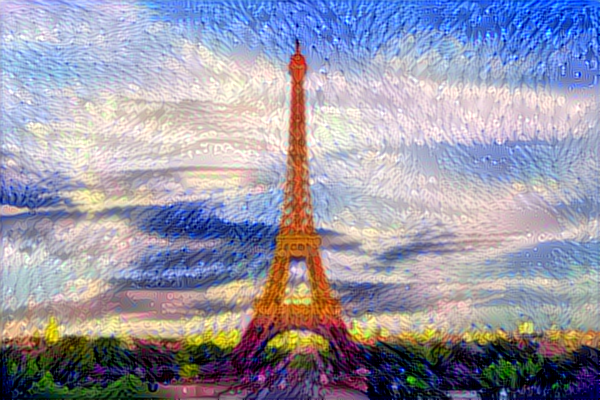

Iteration 1600: loss=3331.58


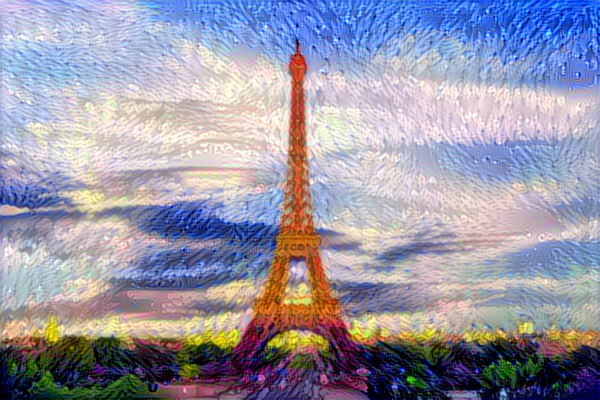

Iteration 1700: loss=3289.96


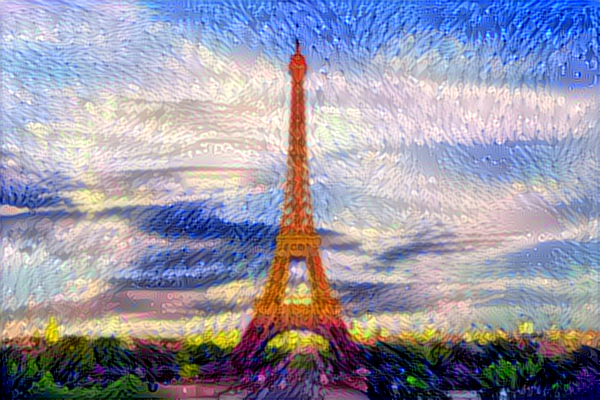

Iteration 1800: loss=3252.12


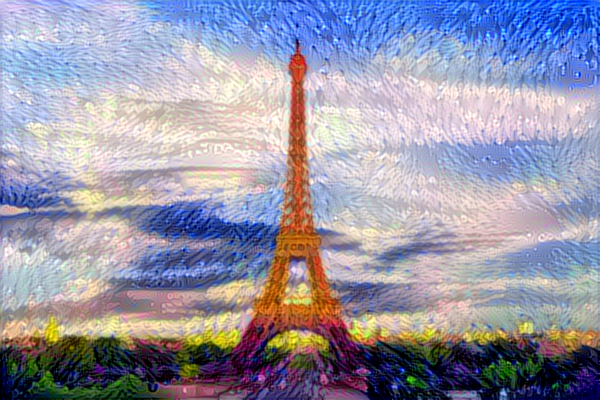

Iteration 1900: loss=3217.46


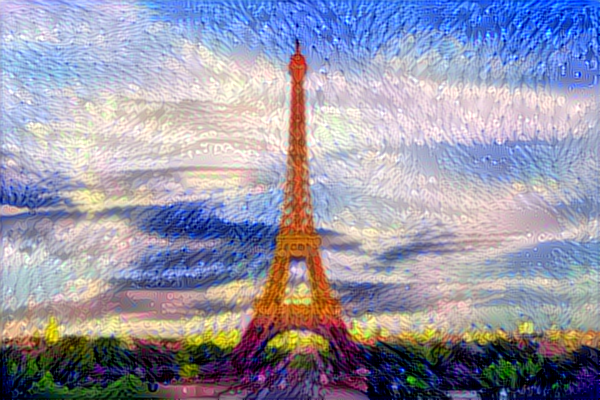

Iteration 2000: loss=3185.62


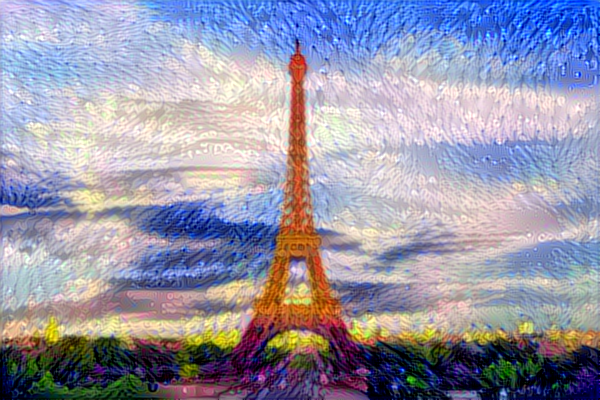

Iteration 2100: loss=3156.28


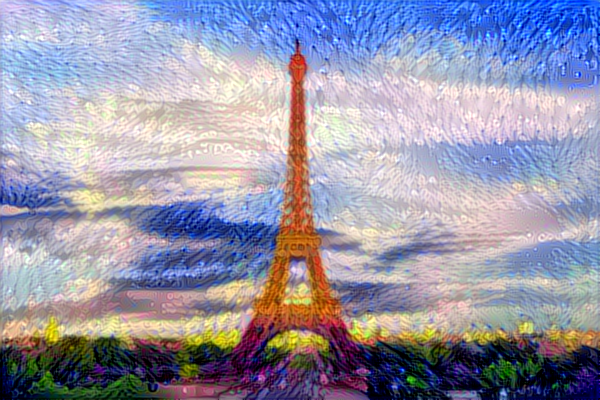

Iteration 2200: loss=3129.14


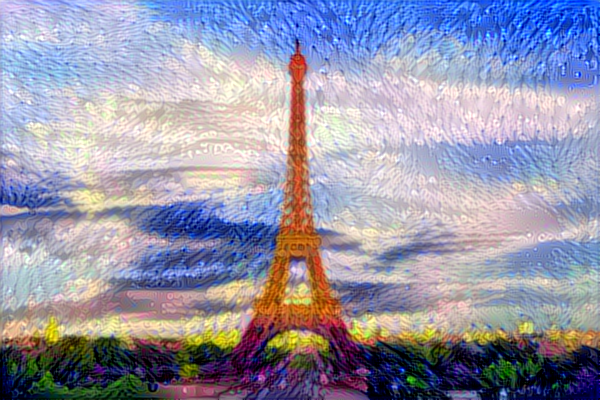

Iteration 2300: loss=3104.04


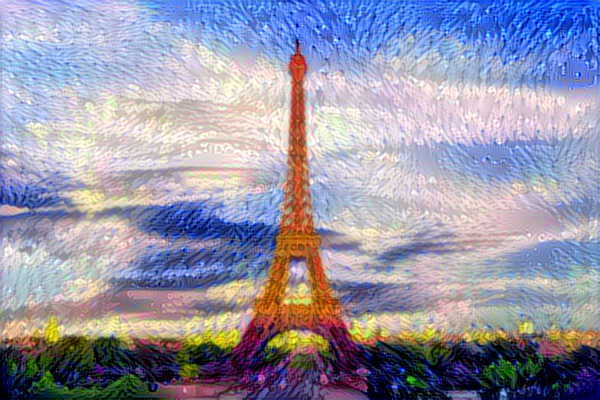

Iteration 2400: loss=3080.77


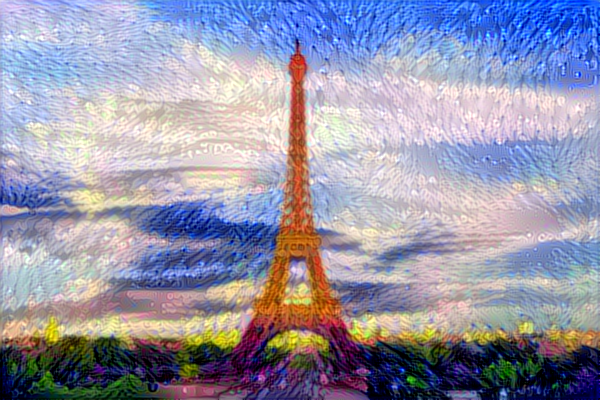

Iteration 2500: loss=3059.16


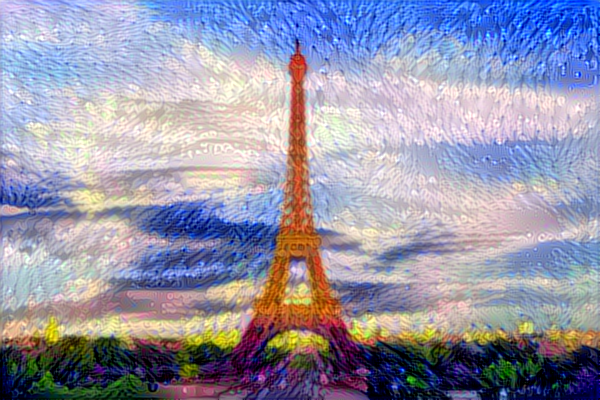

Iteration 2600: loss=3039.05


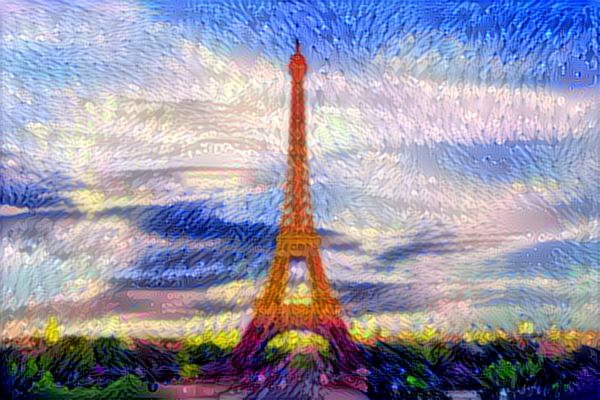

Iteration 2700: loss=3020.25


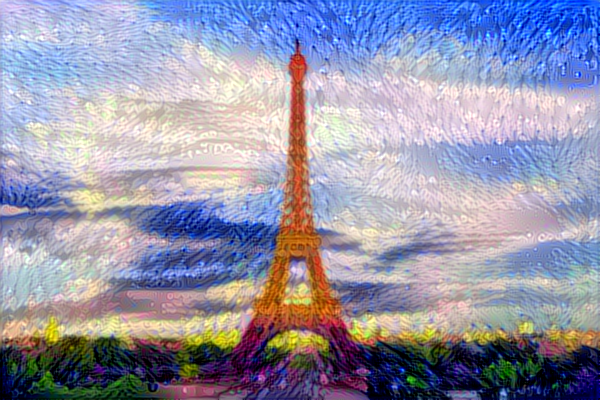

Iteration 2800: loss=3002.69


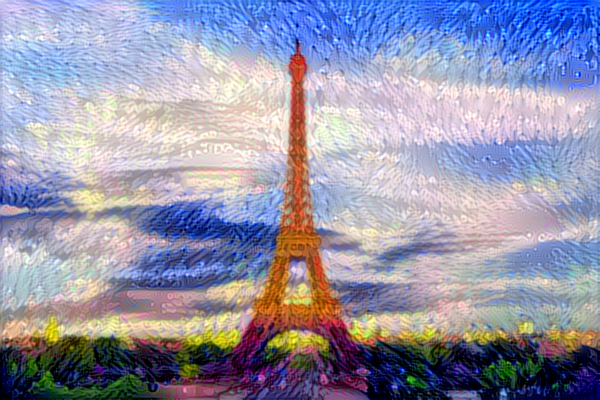

Iteration 2900: loss=2986.29


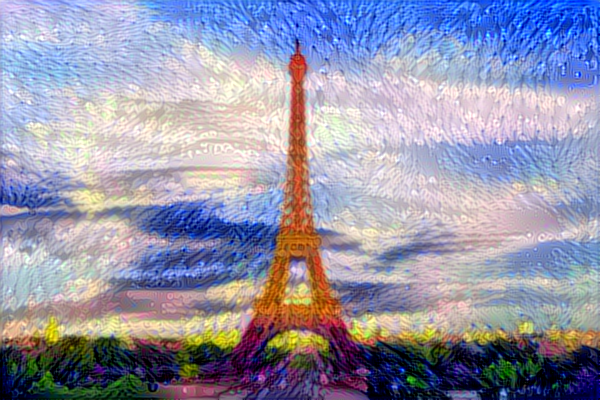

Iteration 3000: loss=2970.92


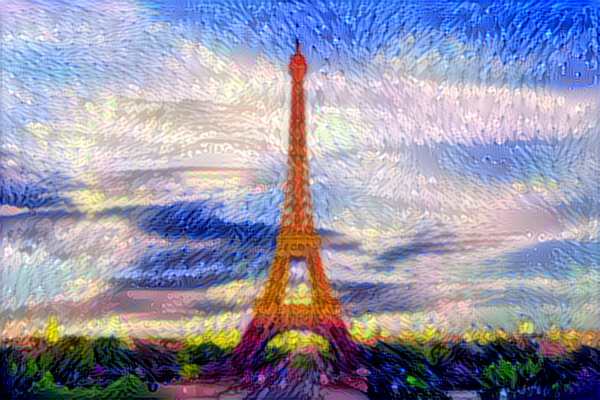

Iteration 3100: loss=2956.49


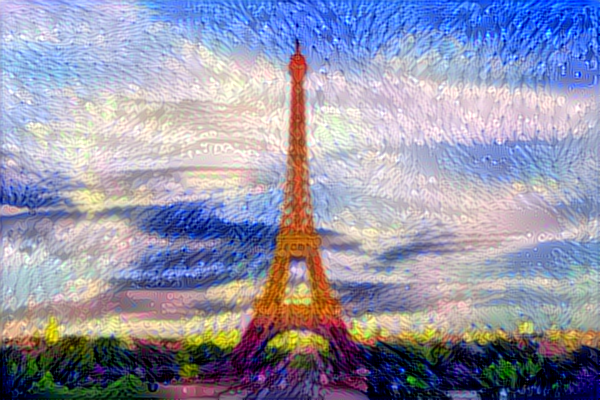

Iteration 3200: loss=2942.93


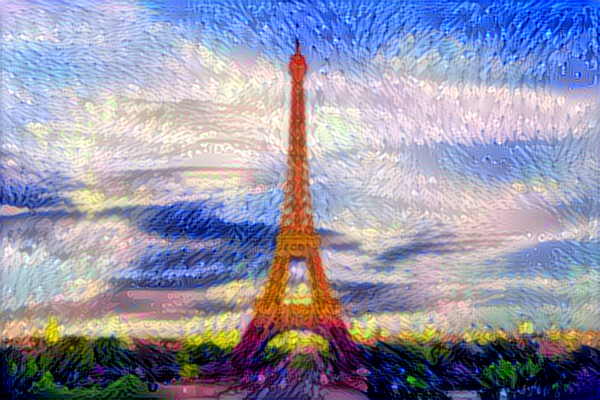

Iteration 3300: loss=2930.18


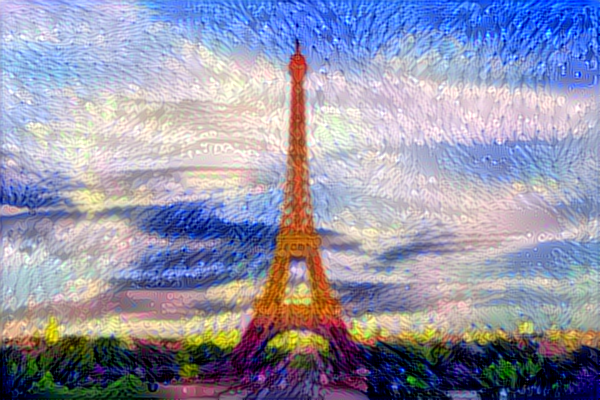

Iteration 3400: loss=2918.16


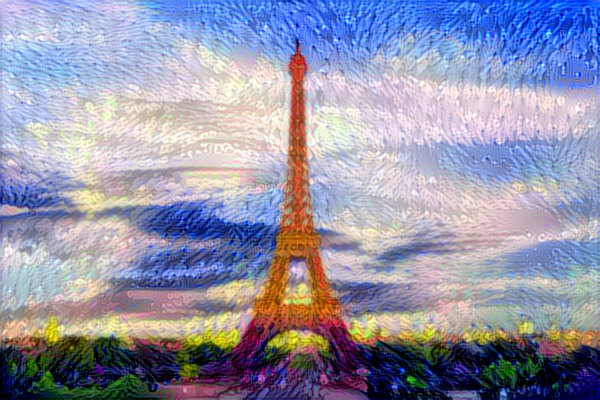

Iteration 3500: loss=2906.83


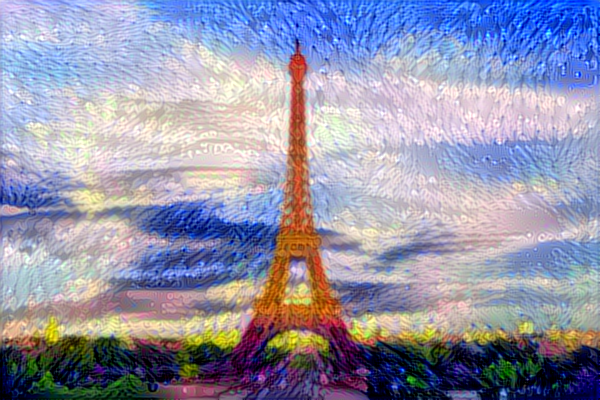

Iteration 3600: loss=2896.16


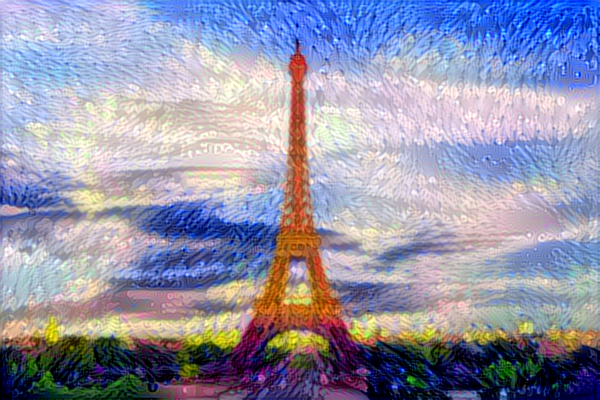

Iteration 3700: loss=2886.07


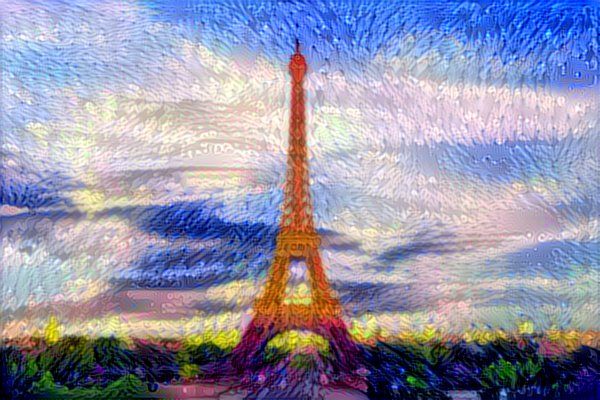

Iteration 3800: loss=2876.54


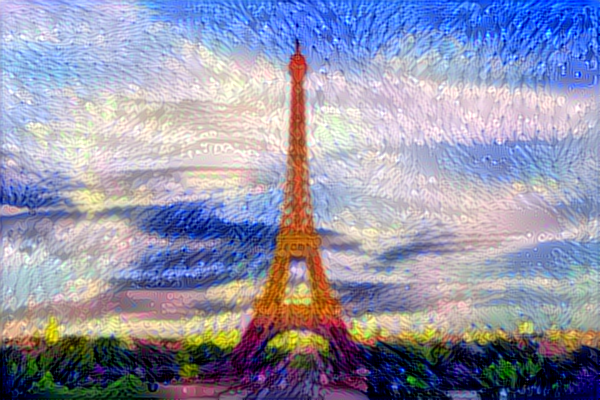

Iteration 3900: loss=2867.54


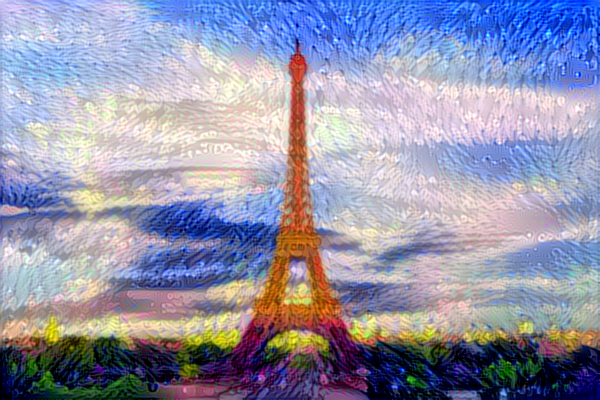

Iteration 4000: loss=2859.02


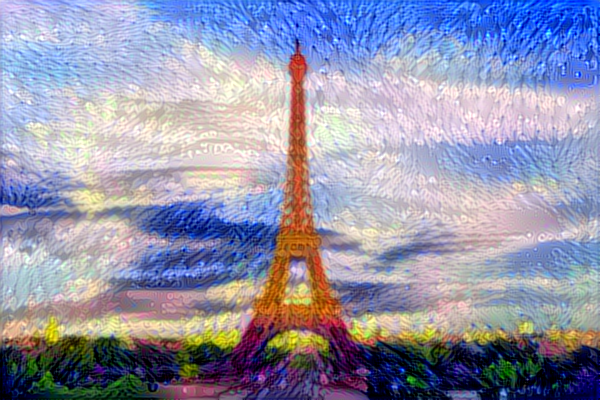

Iteration 4100: loss=2850.95


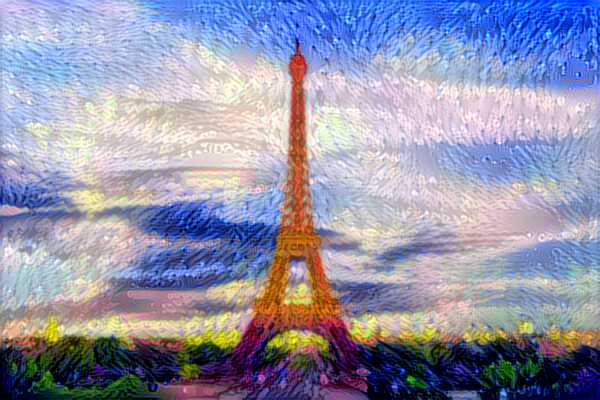

Iteration 4200: loss=2843.31


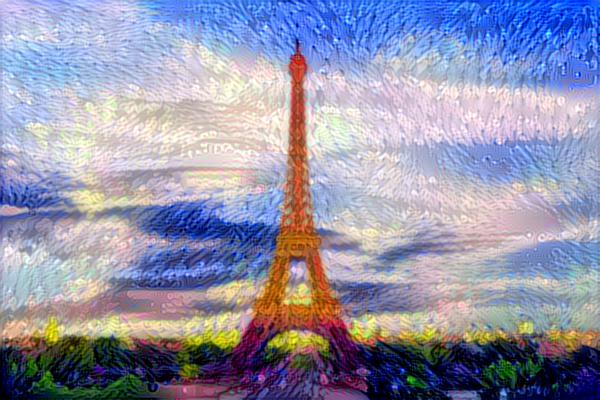

Iteration 4300: loss=2836.05


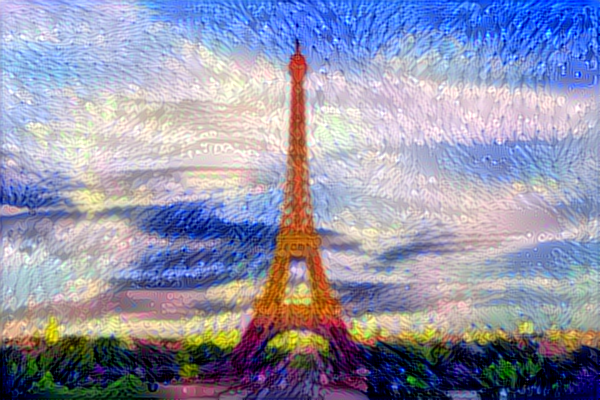

Iteration 4400: loss=2829.17


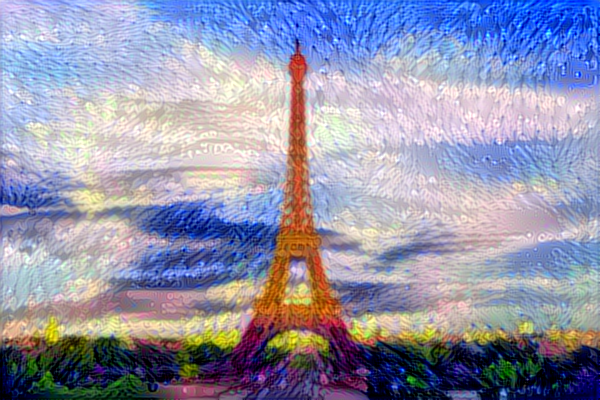

Iteration 4500: loss=2822.62


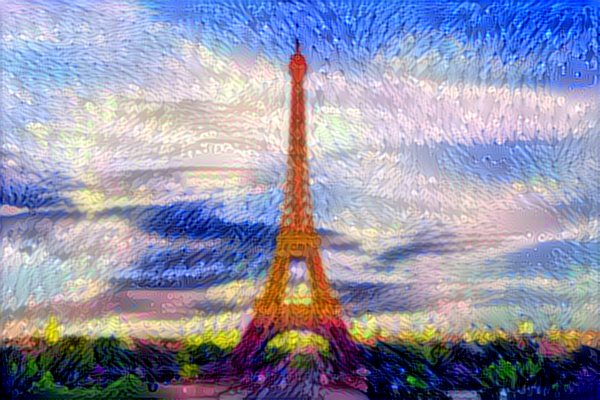

Iteration 4600: loss=2816.40


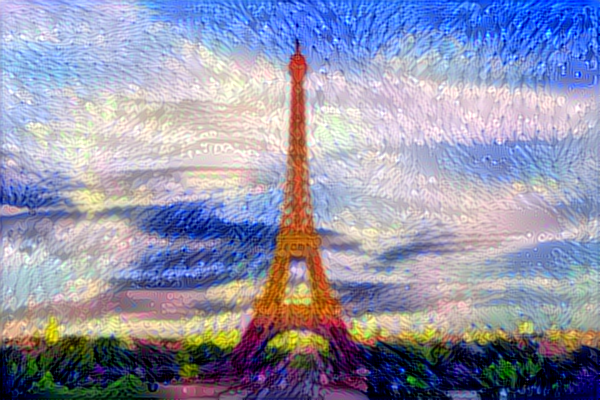

Iteration 4700: loss=2810.49


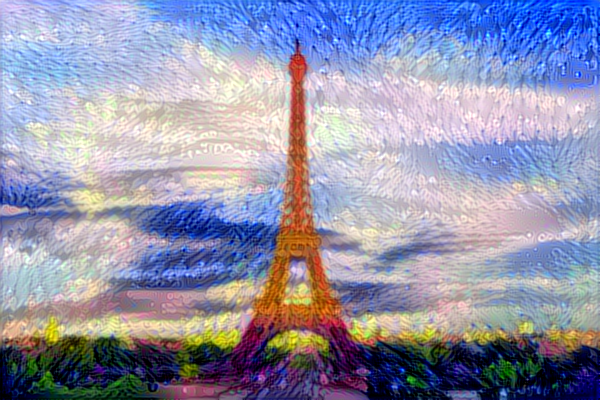

Iteration 4800: loss=2804.86


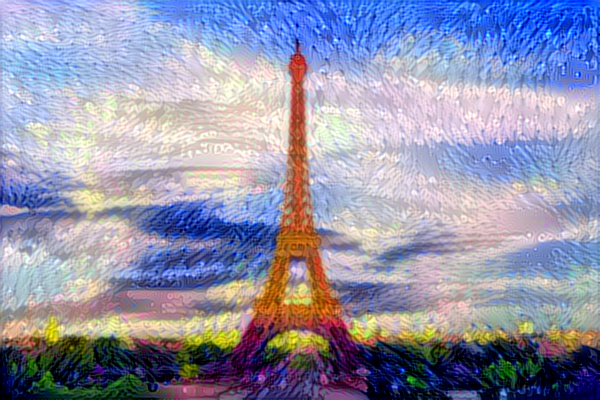

Iteration 4900: loss=2799.51


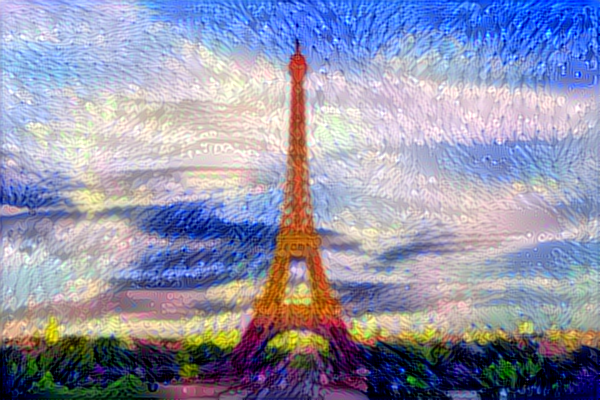

Iteration 5000: loss=2794.41


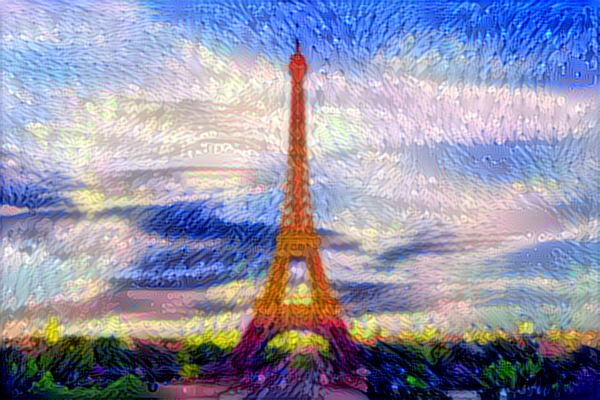

In [ ]:
optimizer = keras.optimizers.SGD(
    keras.optimizers.schedules.ExponentialDecay(
        initial_learning_rate=100.0, decay_steps=100, decay_rate=0.96
    )
)

base_image = preprocess_image(base_image_path)
style_reference_image = preprocess_image(style_reference_image_path)
combination_image = tf.Variable(preprocess_image(base_image_path))

iterations = 5000
for i in range(1, iterations + 1):
    loss, grads = compute_loss_and_grads(
        combination_image, base_image, style_reference_image
    )
    optimizer.apply_gradients([(grads, combination_image)])
    if i % 100 == 0:
        print("Iteration %d: loss=%.2f" % (i, loss))
        img = deprocess_image(combination_image.numpy())
        fname = result_prefix + "_at_iteration_%d.png" % i
        keras.preprocessing.image.save_img(fname, img)
        display(Image(result_prefix + "_at_iteration_%d.png" %i))


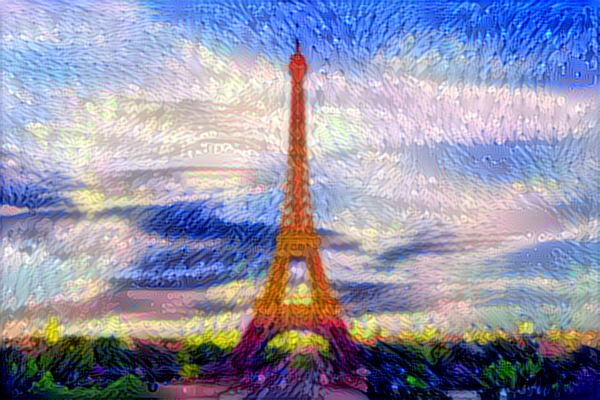

In [ ]:
display(Image(result_prefix + "_at_iteration_5000.png"))
